# Statistical inference of stock returns with linear regression

## Imports & Settings

In [71]:
import warnings
warnings.filterwarnings('ignore')

In [72]:
%matplotlib inline

import pandas as pd

from statsmodels.api import OLS, add_constant, graphics
from statsmodels.graphics.tsaplots import plot_acf
from scipy.stats import norm

import seaborn as sns
import matplotlib.pyplot as plt

In [73]:
sns.set_style('whitegrid')
idx = pd.IndexSlice

## Load Data

In [74]:
with pd.HDFStore('data.h5') as store:
    data = (store['model_data']
            .dropna()
            .drop(['open', 'close', 'low', 'high'], axis=1))

### Select Investment Universe

In [75]:
data = data[data.dollar_vol_rank<100]

In [76]:
data.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 109675 entries, ('AAL', Timestamp('2013-07-25 00:00:00')) to ('ZTS', Timestamp('2014-12-04 00:00:00'))
Data columns (total 65 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   volume                 109675 non-null  float64
 1   dollar_vol             109675 non-null  float64
 2   dollar_vol_1m          109675 non-null  float64
 3   dollar_vol_rank        109675 non-null  float64
 4   rsi                    109675 non-null  float64
 5   bb_high                109675 non-null  float64
 6   bb_low                 109675 non-null  float64
 7   atr                    109675 non-null  float64
 8   macd                   109675 non-null  float64
 9   return_1d              109675 non-null  float64
 10  return_5d              109675 non-null  float64
 11  return_10d             109675 non-null  float64
 12  return_21d             109675 non-null  float64
 13  return_42d    

### Create Model Data

| Column | What it means | How it's calculated |
| --- | --- | --- |
| `return_5d` | Past 5-day return (ending today) | pct_change(5) over close price |
| `target_5d` | Next 5-day return (starting today) | `return_5d` shifted -5 rows |


In [77]:
y = data.filter(like='target')
X = data.drop(y.columns, axis=1)
X = X.drop(['dollar_vol', 'dollar_vol_rank', 'volume', 'consumer_durables'], axis=1)

## Explore Data

### Context and Purpose

-   **y** contains the target variables (future returns), so the first cluster map helps explore how returns over different horizons (1-day, 5-day, etc.) correlate with each other.

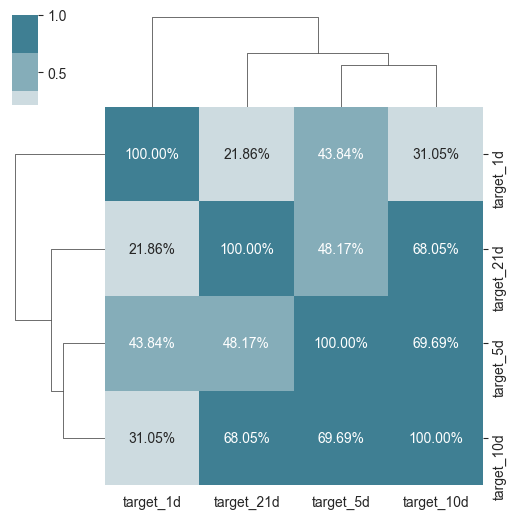

In [78]:
sns.clustermap(
    y.corr(), 
    cmap=sns.diverging_palette(h_neg=20, h_pos=220),
    center=0, 
    annot=True, 
    fmt='.2%');
plt.gcf().set_size_inches((5, 5))

-   **X** contains the features (past returns, technical indicators, etc.), so the second cluster map reveals relationships among the predictors, which is useful for identifying multicollinearity (when features are highly correlated with each other) before running regression models.

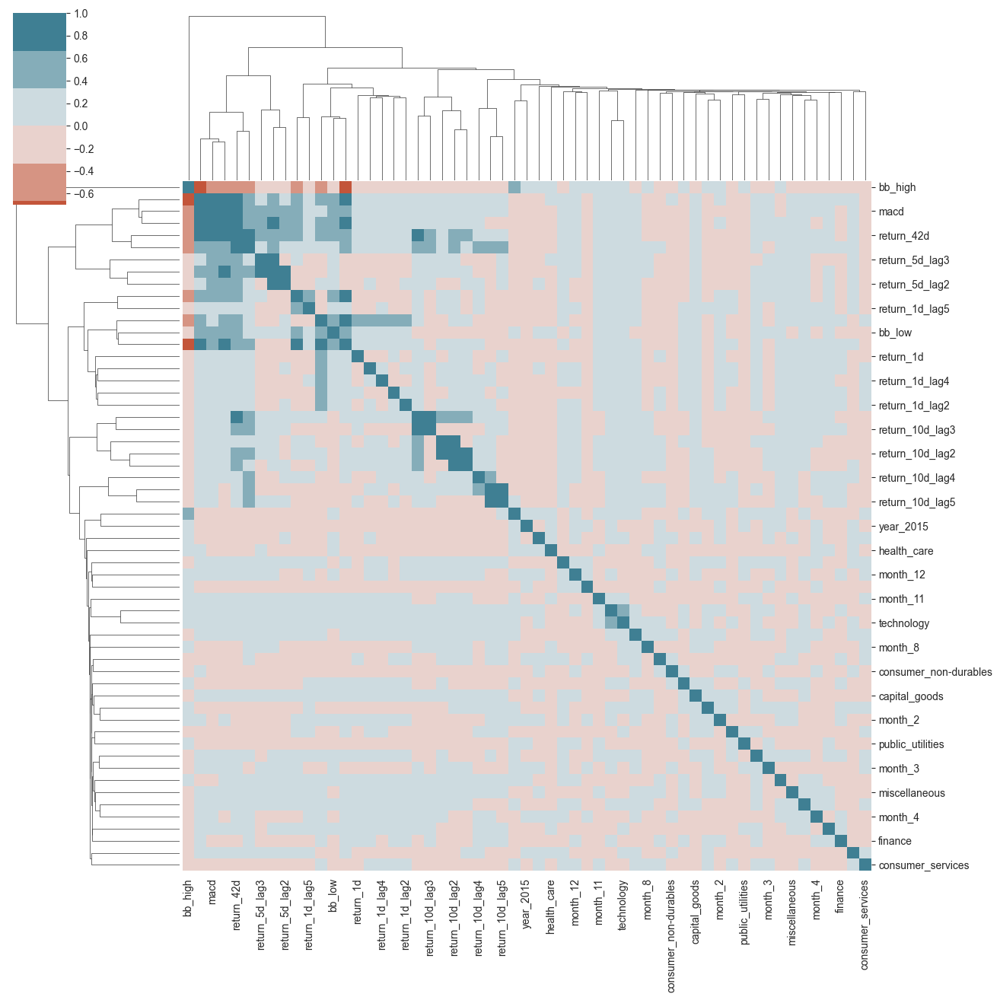

In [79]:
sns.clustermap(
    X.corr(), 
    cmap=sns.diverging_palette(h_neg=20, h_pos=220), 
    center=0);
plt.gcf().set_size_inches((14, 14))

### **Summary Table**

| **Scenario**                  | **Interpretation**                                      | **Impact on Linear Regression**                     |
|-------------------------------|---------------------------------------------------------|-----------------------------------------------------|
| **High Target-Feature Correlation** | Strong linear relationship; feature predicts target well. | Improves accuracy; feature is a strong predictor.  |
| **Low Target-Feature Correlation**  | Weak linear relationship; feature less informative.     | May add noise; less useful for prediction.         |
| **High Target-Target Correlation**  | Targets move together; similar underlying factors.      | Indirectly suggests consistent predictors.         |
| **Low Target-Target Correlation**   | Targets independent; different factors at play.         | May need distinct features/models per target.      |
| **High Feature-Feature Correlation** | Multicollinearity; features overlap.                   | Unstable, unreliable coefficients.                 |
| **Low Feature-Feature Correlation**  | Features unique; no overlap.                           | Stable, interpretable coefficients.                |


The first part of the code calculates and processes a correlation matrix for the features in X (a DataFrame containing various features like past returns or technical indicators). Here's how it works:

-   **`corr_mat = X.corr().stack().reset_index()`**
    -   `X.corr()`: Computes the Pearson correlation matrix for all features in X. This matrix shows how each feature correlates with every other feature (values range from -1 to 1).
    -   `.stack()`: Converts the matrix into a long format, creating a Series of feature pairs and their correlation values.
    -   `.reset_index()`: Turns this Series into a DataFrame with three columns: two for the feature names and one for the correlation.
-   **`corr_mat.columns = ['var1', 'var2', 'corr']`**
    -   Renames the columns to `var1` (first feature), `var2` (second feature), and corr (correlation value) for clarity.
-   **`corr_mat = corr_mat[corr_mat.var1 != corr_mat.var2].sort_values(by='corr', ascending=False)`**
    -   `corr_mat.var1 != corr_mat.var2`: Filters out rows where a feature is correlated with itself (self-correlations are always 1 and uninformative).
    -   `.sort_values(by='corr', ascending=False)`: Sorts the remaining rows by correlation value, from highest (most positive) to lowest (most negative).

In [80]:
corr_mat = X.corr().stack().reset_index()
corr_mat.columns=['var1', 'var2', 'corr']
corr_mat = corr_mat[corr_mat.var1!=corr_mat.var2].sort_values(by='corr', ascending=False)

**pd.concat([corr_mat.head(), corr_mat.tail()])**

-   `corr_mat.head()`: Takes the top 5 rows (highest positive correlations).
-   `corr_mat.tail()`: Takes the bottom 5 rows (lowest, often negative, correlations).
-   `pd.concat()`: Combines these into a single DataFrame to show the most extreme correlations.

In [81]:
# corr_mat.head().append(corr_mat.tail())
pd.concat([corr_mat.head(), corr_mat.tail()])

,var1,var2,corr
581,return_42d,return_63d,0.835634
637,return_63d,return_42d,0.835634
286,macd,rsi,0.817113
62,rsi,macd,0.817113
518,return_21d,macd,0.793893
515,return_21d,bb_high,-0.632777
122,bb_high,return_10d,-0.693640
458,return_10d,bb_high,-0.693640
59,rsi,bb_high,-0.696555
115,bb_high,rsi,-0.696555


##### **Key Concepts**

-   **Correlation**: Measures how two variables move together:
    -   Positive (0 to 1): As one increases, the other tends to increase.
    -   Negative (-1 to 0): As one increases, the other tends to decrease.
    -   Close to 0: Little to no linear relationship.

##### **High Positive Correlations**

-   **return_42d and return_63d (0.835634)**
    -   These are past returns over 42 and 63 days. Their high correlation means they move together strongly---stocks with high 42-day returns also tend to have high 63-day returns. This makes sense, as both capture longer-term trends.
    -   Note: The pairs appear twice (e.g., return_42d vs. return_63d and vice versa) because the correlation matrix is symmetric.
-   **macd and rsi (0.817113)**
    -   MACD (a momentum indicator) and RSI (a strength indicator) are technical trading metrics. Their high correlation suggests they often signal similar market conditions (e.g., bullish or bearish momentum).
-   **return_21d and macd (0.793893)**
    -   The 21-day return and MACD are closely related, indicating that recent price trends align with momentum signals from MACD.

**Implication**: High positive correlations suggest these features may carry similar information. If you're building a model (e.g., linear regression), this could indicate **multicollinearity**, which might require feature selection or regularization.

##### **High Negative Correlations**

-   **return_21d and bb_high (-0.632777)**
    -   bb_high is likely the upper Bollinger Band (indicating high prices relative to volatility). A negative correlation means higher bb_high values are associated with lower 21-day past returns, possibly signaling overbought conditions or reversals.
-   **bb_high and return_10d (-0.693640)**
    -   Similarly, a high upper Bollinger Band correlates with lower 10-day returns, reinforcing the idea of potential price reversals.
-   **rsi and bb_high (-0.696555)**
    -   RSI and the upper Bollinger Band move in opposite directions. When RSI is high (overbought), bb_high tends to be lower, and vice versa. This might reflect differences in how these indicators measure market conditions.

**Implication**: Negative correlations can be valuable for prediction, as they capture opposing trends in the data.

**y.boxplot();**

-   Creates a box plot for each column in y (a DataFrame with target variables, likely future returns over different time horizons, e.g., 1-day, 5-day, etc.).
-   A box plot shows the distribution of each target, including the median, spread, and any outliers.

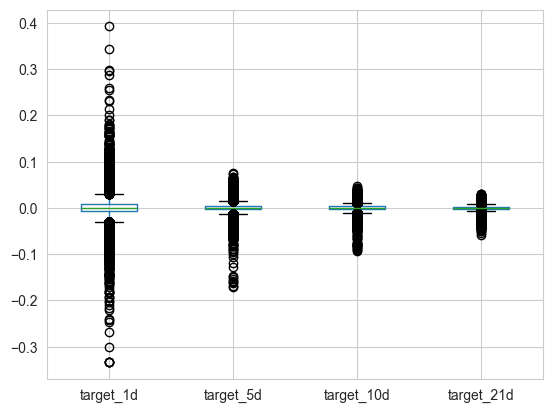

In [82]:
y.boxplot();

In [83]:
import plotly.express as px
fig = px.box(y, y=y.columns)
fig.update_layout(height=800)  # Set height to 800 pixels for a taller graph
fig.show()

## Linear Regression for Statistical Inference: OLS with statsmodels

### Ticker-wise standardization

`statsmodels` warns of high design matrix condition numbers. This can arise when the variables are not standardized and the Eigenvalues differ due to scaling. The following step avoids this warning.

In [84]:
X

dollar_vol_1m        rsi   bb_high    bb_low       atr  \
ticker date                                                                 
AAL    2013-07-25  223614.661574  69.669475  0.011251  0.140777 -0.383445   
       2013-07-26  234821.351626  72.045207  0.007052  0.146370 -0.412740   
       2013-07-29  243001.954091  73.259776  0.008843  0.146963 -0.494894   
       2013-07-30  243122.621493  72.532538  0.018500  0.142355 -0.565684   
       2013-07-31  256336.659780  73.926238  0.016465  0.139949 -0.653399   
...                          ...        ...       ...       ...       ...   
ZTS    2014-11-28  294715.115434  71.884144  0.043559  0.157493  0.397024   
       2014-12-01  297525.671580  67.137279  0.051976  0.131103  0.403122   
       2014-12-02  298272.515355  68.612084  0.041573  0.120638  0.323857   
       2014-12-03  295315.035852  69.175766  0.038192  0.111125  0.236555   
       2014-12-04  286390.276661  61.677853  0.051743  0.080568  0.273293   

                       macd  return_1d  return_5d  return_10d  return_21d  \
ticker date                                                                 
AAL    2013-07-25  0.681257   0.017838   0.004413    0.008103    0.006426   
       2013-07-26  0.772848   0.013808   0.009262    0.008389    0.007936   
       2013-07-29  0.854980   0.007334   0.011627    0.007984    0.007873   
       2013-07-30  0.904814  -0.001560   0.012430    0.006755    0.007476   
       2013-07-31  0.954135   0.007813   0.009025    0.004774    0.006752   
...                     ...        ...        ...         ...         ...   
ZTS    2014-11-28  2.806829   0.005820   0.008117    0.003841    0.009878   
       2014-12-01  2.691178  -0.012464   0.002269    0.002815    0.008365   
       2014-12-02  2.615256   0.008339   0.000717    0.001147    0.009064   
       2014-12-03  2.540352   0.003129   0.004380    0.001551    0.008311   
       2014-12-04  2.329735  -0.019608  -0.003018    0.001374    0.005614   

                   ...  capital_goods  consumer_non-durables  \
ticker date        ...                                         
AAL    2013-07-25  ...          False                  False   
       2013-07-26  ...          False                  False   
       2013-07-29  ...          False                  False   
       2013-07-30  ...          False                  False   
       2013-07-31  ...          False                  False   
...                ...            ...                    ...   
ZTS    2014-11-28  ...          False                  False   
       2014-12-01  ...          False                  False   
       2014-12-02  ...          False                  False   
       2014-12-03  ...          False                  False   
       2014-12-04  ...          False                  False   

                   consumer_services  energy  finance  health_care  \
ticker date                                                          
AAL    2013-07-25              False   False    False        False   
       2013-07-26              False   False    False        False   
       2013-07-29              False   False    False        False   
       2013-07-30              False   False    False        False   
       2013-07-31              False   False    False        False   
...                              ...     ...      ...          ...   
ZTS    2014-11-28              False   False    False         True   
       2014-12-01              False   False    False         True   
       2014-12-02              False   False    False         True   
       2014-12-03              False   False    False         True   
       2014-12-04              False   False    False         True   

                   miscellaneous  public_utilities  technology  transportation  
ticker date                                                                     
AAL    2013-07-25          False             False       False            True  
       2013-07-26          F

### Standardize continuous features per stock

This code takes a DataFrame X with stock data, separates the sector dummies, standardizes the continuous features (like returns) for each stock individually, then puts the dummies back and cleans up any missing values. The result is a preprocessed DataFrame where:

-   Continuous features are standardized (mean = 0, std = 1) per stock.
-   Sector dummies remain unchanged.
-   No missing values exist.

In [85]:
sectors = X.iloc[:, -10:]
X = (X.drop(sectors.columns, axis=1)
     .groupby(level='ticker')
     .transform(lambda x: (x - x.mean()) / x.std())
    .join(sectors)
    .fillna(0))
X

dollar_vol_1m       rsi   bb_high    bb_low       atr  \
ticker date                                                                
AAL    2013-07-25      -1.377498  1.427605 -0.773214  0.535185 -0.461161   
       2013-07-26      -1.308351  1.606301 -0.824760  0.589545 -0.487341   
       2013-07-29      -1.257876  1.697656 -0.802774  0.595311 -0.560761   
       2013-07-30      -1.257131  1.642956 -0.684236  0.550522 -0.624026   
       2013-07-31      -1.175599  1.747786 -0.709213  0.527137 -0.702416   
...                          ...       ...       ...       ...       ...   
ZTS    2014-11-28       0.482447  0.789549 -0.697431  0.231390 -0.457231   
       2014-12-01       0.925568 -0.628407  0.432822 -0.492799 -0.419505   
       2014-12-02       1.043318 -0.187862 -0.963998 -0.779983 -0.909876   
       2014-12-03       0.577032 -0.019482 -1.418054 -1.041020 -1.449963   
       2014-12-04      -0.830073 -2.259217  0.401583 -1.879585 -1.222688   

                       macd  return_1d  return_5d  return_10d  return_21d  \
ticker date                                                                 
AAL    2013-07-25  0.702504   0.639313   0.267036    0.686683    0.794435   
       2013-07-26  0.784250   0.486606   0.559203    0.710383    0.975378   
       2013-07-29  0.857554   0.241291   0.701721    0.676785    0.967823   
       2013-07-30  0.902031  -0.095710   0.750056    0.574837    0.920204   
       2013-07-31  0.946050   0.259434   0.544923    0.410579    0.833460   
...                     ...        ...        ...         ...         ...   
ZTS    2014-11-28  0.456081   0.314405   1.766856   -0.136877    0.987851   
       2014-12-01 -0.181351  -1.004132   0.035205   -0.420698   -0.283072   
       2014-12-02 -0.599807   0.496023  -0.424441   -0.882110    0.303774   
       2014-12-03 -1.012653   0.120329   0.660102   -0.770513   -0.329040   
       2014-12-04 -2.173507  -1.519309  -1.530273   -0.819365   -2.595182   

                   ...  capital_goods  consumer_non-durables  \
ticker date        ...                                         
AAL    2013-07-25  ...          False                  False   
       2013-07-26  ...          False                  False   
       2013-07-29  ...          False                  False   
       2013-07-30  ...          False                  False   
       2013-07-31  ...          False                  False   
...                ...            ...                    ...   
ZTS    2014-11-28  ...          False                  False   
       2014-12-01  ...          False                  False   
       2014-12-02  ...          False                  False   
       2014-12-03  ...          False                  False   
       2014-12-04  ...          False                  False   

                   consumer_services  energy  finance  health_care  \
ticker date                                                          
AAL    2013-07-25              False   False    False        False   
       2013-07-26              False   False    False        False   
       2013-07-29              False   False    False        False   
       2013-07-30              False   False    False        False   
       2013-07-31              False   False    False        False   
...                              ...     ...      ...          ...   
ZTS    2014-11-28              False   False    False         True   
       2014-12-01              False   False    False         True   
       2014-12-02              False   False    False         True   
       2014-12-03              False   False    False         True   
       2014-12-04              False   False    False         True   

                   miscellaneous  public_utilities  technology  transportation  
ticker date                                                                     
AAL    2013-07-25          False             False       False            True  
       2013-07-26          False         

### 1-Day Returns

-   The input `X` is assumed to be a DataFrame containing predictor variables (features).
-   Boolean columns in `X` are converted to floats (e.g., `True` becomes `1.0`, `False` becomes `0.0`) to ensure compatibility with the OLS model, which requires numeric inputs. This is done by:

In [86]:
# Convert boolean columns in X to float to avoid dtype issues
X_numeric = X.copy()
for col in X_numeric.select_dtypes(include='bool').columns:
	X_numeric[col] = X_numeric[col].astype(float)
X_numeric

dollar_vol_1m       rsi   bb_high    bb_low       atr  \
ticker date                                                                
AAL    2013-07-25      -1.377498  1.427605 -0.773214  0.535185 -0.461161   
       2013-07-26      -1.308351  1.606301 -0.824760  0.589545 -0.487341   
       2013-07-29      -1.257876  1.697656 -0.802774  0.595311 -0.560761   
       2013-07-30      -1.257131  1.642956 -0.684236  0.550522 -0.624026   
       2013-07-31      -1.175599  1.747786 -0.709213  0.527137 -0.702416   
...                          ...       ...       ...       ...       ...   
ZTS    2014-11-28       0.482447  0.789549 -0.697431  0.231390 -0.457231   
       2014-12-01       0.925568 -0.628407  0.432822 -0.492799 -0.419505   
       2014-12-02       1.043318 -0.187862 -0.963998 -0.779983 -0.909876   
       2014-12-03       0.577032 -0.019482 -1.418054 -1.041020 -1.449963   
       2014-12-04      -0.830073 -2.259217  0.401583 -1.879585 -1.222688   

                       macd  return_1d  return_5d  return_10d  return_21d  \
ticker date                                                                 
AAL    2013-07-25  0.702504   0.639313   0.267036    0.686683    0.794435   
       2013-07-26  0.784250   0.486606   0.559203    0.710383    0.975378   
       2013-07-29  0.857554   0.241291   0.701721    0.676785    0.967823   
       2013-07-30  0.902031  -0.095710   0.750056    0.574837    0.920204   
       2013-07-31  0.946050   0.259434   0.544923    0.410579    0.833460   
...                     ...        ...        ...         ...         ...   
ZTS    2014-11-28  0.456081   0.314405   1.766856   -0.136877    0.987851   
       2014-12-01 -0.181351  -1.004132   0.035205   -0.420698   -0.283072   
       2014-12-02 -0.599807   0.496023  -0.424441   -0.882110    0.303774   
       2014-12-03 -1.012653   0.120329   0.660102   -0.770513   -0.329040   
       2014-12-04 -2.173507  -1.519309  -1.530273   -0.819365   -2.595182   

                   ...  capital_goods  consumer_non-durables  \
ticker date        ...                                         
AAL    2013-07-25  ...            0.0                    0.0   
       2013-07-26  ...            0.0                    0.0   
       2013-07-29  ...            0.0                    0.0   
       2013-07-30  ...            0.0                    0.0   
       2013-07-31  ...            0.0                    0.0   
...                ...            ...                    ...   
ZTS    2014-11-28  ...            0.0                    0.0   
       2014-12-01  ...            0.0                    0.0   
       2014-12-02  ...            0.0                    0.0   
       2014-12-03  ...            0.0                    0.0   
       2014-12-04  ...            0.0                    0.0   

                   consumer_services  energy  finance  health_care  \
ticker date                                                          
AAL    2013-07-25                0.0     0.0      0.0          0.0   
       2013-07-26                0.0     0.0      0.0          0.0   
       2013-07-29                0.0     0.0      0.0          0.0   
       2013-07-30                0.0     0.0      0.0          0.0   
       2013-07-31                0.0     0.0      0.0          0.0   
...                              ...     ...      ...          ...   
ZTS    2014-11-28                0.0     0.0      0.0          1.0   
       2014-12-01                0.0     0.0      0.0          1.0   
       2014-12-02                0.0     0.0      0.0          1.0   
       2014-12-03                0.0     0.0      0.0          1.0   
       2014-12-04                0.0     0.0      0.0          1.0   

                   miscellaneous  public_utilities  technology  transportation  
ticker date                                                                     
AAL    2013-07-25            0.0               0.0         0.0             1.0  
       2013-07-26            0.0         

In [87]:
target = 'target_1d'
model = OLS(endog=y[target], exog=add_constant(X_numeric))
trained_model = model.fit()
print(trained_model.summary())

                            OLS Regression Results                            
Dep. Variable:              target_1d   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     19.03
Date:                Mon, 02 Jun 2025   Prob (F-statistic):          9.43e-189
Time:                        14:27:56   Log-Likelihood:             2.8852e+05
No. Observations:              109675   AIC:                        -5.769e+05
Df Residuals:                  109617   BIC:                        -5.764e+05
Df Model:                          57                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.00

### 5-Day Returns

In [88]:
target = 'target_5d'
model = OLS(endog=y[target], exog=add_constant(X_numeric))
trained_model = model.fit()
print(trained_model.summary())

                            OLS Regression Results                            
Dep. Variable:              target_5d   R-squared:                       0.031
Model:                            OLS   Adj. R-squared:                  0.031
Method:                 Least Squares   F-statistic:                     61.86
Date:                Mon, 02 Jun 2025   Prob (F-statistic):               0.00
Time:                        14:27:57   Log-Likelihood:             3.7883e+05
No. Observations:              109675   AIC:                        -7.575e+05
Df Residuals:                  109617   BIC:                        -7.570e+05
Df Model:                          57                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.00

#### Obtain the residuals

In [89]:
preds = trained_model.predict(add_constant(X))
residuals = y[target] - preds
residuals

ticker  date      
AAL     2013-07-25    0.003748
        2013-07-26   -0.004325
        2013-07-29    -0.00341
        2013-07-30   -0.005813
        2013-07-31   -0.007453
                        ...   
ZTS     2014-11-28    -0.00313
        2014-12-01   -0.000914
        2014-12-02   -0.002555
        2014-12-03   -0.009997
        2014-12-04    -0.01264
Length: 109675, dtype: object

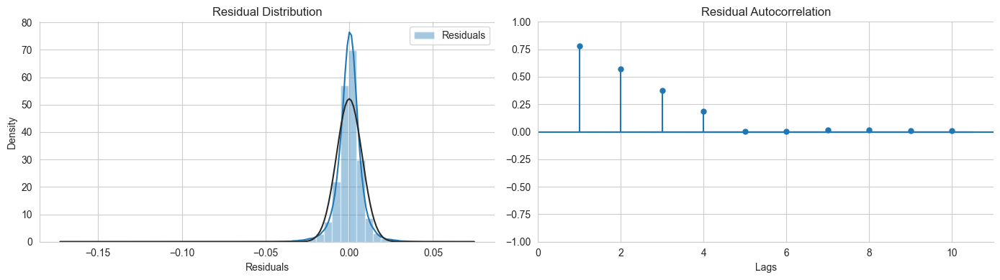

In [90]:
fig, axes = plt.subplots(ncols=2, figsize=(14,4))
sns.distplot(residuals, fit=norm, ax=axes[0], axlabel='Residuals', label='Residuals')
axes[0].set_title('Residual Distribution')
axes[0].legend()
plot_acf(residuals, lags=10, zero=False, ax=axes[1], title='Residual Autocorrelation')
axes[1].set_xlabel('Lags')
sns.despine()
fig.tight_layout();

### 10-Day Returns

In [91]:
target = 'target_10d'
model = OLS(endog=y[target], exog=add_constant(X_numeric))
trained_model = model.fit()
print(trained_model.summary())

                            OLS Regression Results                            
Dep. Variable:             target_10d   R-squared:                       0.043
Model:                            OLS   Adj. R-squared:                  0.042
Method:                 Least Squares   F-statistic:                     85.38
Date:                Mon, 02 Jun 2025   Prob (F-statistic):               0.00
Time:                        14:28:02   Log-Likelihood:             4.1892e+05
No. Observations:              109675   AIC:                        -8.377e+05
Df Residuals:                  109617   BIC:                        -8.372e+05
Df Model:                          57                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.00

### Monthly Returns

In [92]:
target = 'target_21d'
model = OLS(endog=y[target], exog=add_constant(X_numeric))
trained_model = model.fit()
print(trained_model.summary())

                            OLS Regression Results                            
Dep. Variable:             target_21d   R-squared:                       0.059
Model:                            OLS   Adj. R-squared:                  0.058
Method:                 Least Squares   F-statistic:                     119.7
Date:                Mon, 02 Jun 2025   Prob (F-statistic):               0.00
Time:                        14:28:02   Log-Likelihood:             4.6155e+05
No. Observations:              109675   AIC:                        -9.230e+05
Df Residuals:                  109617   BIC:                        -9.224e+05
Df Model:                          57                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                    -0.00